In [1]:
import sys
sys.path.insert(1,'/home/spencer/research/OpenRadar') # needed to import openradar not in folder
try: sys.path.remove('/opt/ros/kinetic/lib/python2.7/dist-packages') # fixes issues with env variables
except: pass

In [2]:
import numpy as np
import mmwave as mm
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pickle
import os
import copy
from scipy.ndimage import gaussian_filter1d
from scipy import interpolate
from sklearn.preprocessing import minmax_scale
import PIL

sys.path.insert(0,'..')
from pcp import pcp,complex_pcp,radar_pcp

## Getting the Data

In [3]:
radar_frames_path = '../radar_frames_csl_lobby_700.txt'
cfg_path = '/home/spencer/research/ti-radar-hardware/mmWave/scripts/configs/14xx/indoor_human_rcs.cfg' #radar config
rgb_dir_path = '/home/spencer/research/radar-rgb-bfs/RGB_images'
camera_matrix_path = '../camera_mat.npy'

radar_frames = pickle.load(open(radar_frames_path,'rb'))
iwr_cfg_cmd = mm.dataloader.cfg_list_from_cfg(cfg_path) # this is the config sent to the radar
iwr_cfg_dict = mm.dataloader.cfg_list_to_dict(iwr_cfg_cmd) # this is the dictionary of config


images = np.array([plt.imread(os.path.join(rgb_dir_path, 'rgb_{}.png'.format(i)), 'gray') for i in range(len(radar_frames))])

camera_mat = np.load(camera_matrix_path)
fx = camera_mat[0,0]
x_c = camera_mat[0,2]

print('\n%d Radar Frames and %d RGB Frames Loaded'%(len(radar_frames),len(images)))

[NOTE] Azimuth angle can be determined from channel config.
[NOTE] Complex 1x mode

50 Radar Frames and 50 RGB Frames Loaded


In [4]:
# range resolution and bandwidth computation
(range_res, band_width) = mm.dsp.range_resolution(iwr_cfg_dict['profiles'][0]['adcSamples'],
                                                  iwr_cfg_dict['profiles'][0]['adcSampleRate'] / 1000,
                                                  iwr_cfg_dict['profiles'][0]['freqSlopeConst'] / 1e12)
# Doppler velocity resolution
dop_res = mm.dsp.doppler_resolution(band_width,
                                     start_freq_const=iwr_cfg_dict['profiles'][0]['start_frequency'] / 1e9,
                                     ramp_end_time=iwr_cfg_dict['profiles'][0]['rampEndTime'] * 1e6,
                                     idle_time_const=iwr_cfg_dict['profiles'][0]['idle'] * 1e6,
                                     num_loops_per_frame=iwr_cfg_dict['numChirps'] / len(iwr_cfg_dict['chirps']),
                                     num_tx_antennas=iwr_cfg_dict['numTx'])

## Display Original Data

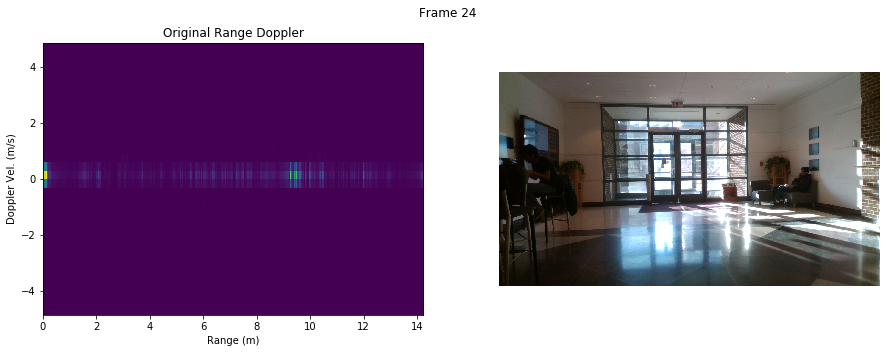

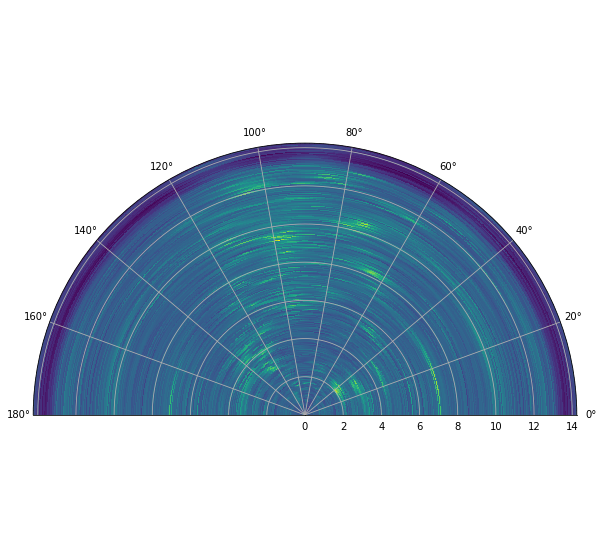

In [5]:
random_int = np.random.randint(0,len(radar_frames))
test_radar_frame = radar_frames[random_int]

test_radar_cube = mm.dsp.range_processing(test_radar_frame)
(test_log_doppler_cube, test_doppler_cube) = mm.dsp.doppler_processing(test_radar_cube,
                                             num_tx_antennas=iwr_cfg_dict['numTx'], clutter_removal_enabled=False,
                                             interleaved=False, window_type_2d=mm.dsp.utils.Window.HAMMING,
                                             accumulate=False,phase_correction=True)

test_doppler_cube = np.fft.fftshift(test_doppler_cube, axes=(2,))
test_log_doppler_cube = np.fft.fftshift(test_log_doppler_cube, axes=(2,))



plt.figure(figsize=(15,5))
plt.suptitle('Frame %d'%random_int)
plt.subplot(121)
plt.imshow(np.abs(test_doppler_cube[:,0]).T,aspect='auto',origin='lower', 
           extent=[0,304*range_res,-test_log_doppler_cube.shape[2] * dop_res / 2, test_log_doppler_cube.shape[2] * dop_res / 2])
plt.title('Original Range Doppler')
plt.xlabel('Range (m)')
plt.ylabel('Doppler Vel. (m/s)')
plt.subplot(122)
plt.imshow(images[random_int])
plt.axis('off')
plt.show()



BINS_PROCESSED = test_doppler_cube.shape[0]  # If you want to zoom in plot, make this 120
VIRT_ANT = test_doppler_cube.shape[1]  # virtual antennas because we use time division multiple access to simulate a larger antenna array
DOPPLER_BINS = test_doppler_cube.shape[2]
ANGLE_RES = 1  # 1 degree resolution
ANGLE_RANGE = 90 # so we get 181 angle bins [0,180]
ANGLE_BINS = (ANGLE_RANGE * 2) // ANGLE_RES + 1
range_azimuth = np.zeros((ANGLE_BINS, BINS_PROCESSED), dtype=np.complex_)
num_vec, steering_vec = mm.dsp.gen_steering_vec(ANGLE_RANGE, ANGLE_RES, VIRT_ANT) # steering vector is a(theta) in most literature

beamforming_result = np.zeros([BINS_PROCESSED,ANGLE_BINS],dtype=np.complex_) # range bins x angle bins


for jj in range(BINS_PROCESSED):
    beamforming_result[jj,:], _ = mm.dsp.aoa_capon(test_doppler_cube[jj], steering_vec)

plt.figure(figsize=(15,10))
plt.tight_layout(True)
plt.subplot(111, projection='polar')
azimuths = np.radians(np.linspace(0, 180, 181))
zeniths = np.linspace(0, range_res*BINS_PROCESSED, BINS_PROCESSED)
r, theta = np.meshgrid(zeniths, azimuths)
values = beamforming_result.T
plt.pcolormesh(theta, r, np.log(np.abs(values)))
plt.grid()
plt.xlim([0,np.pi])
plt.show()

## Clutter Suppression

#### Subtract Mean Over Chirps for each frame

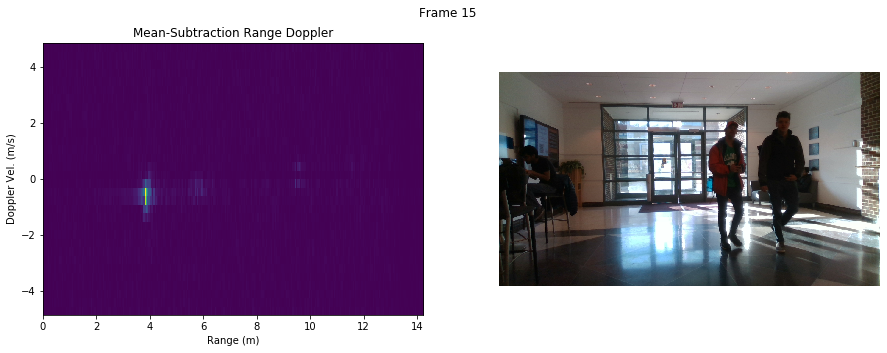

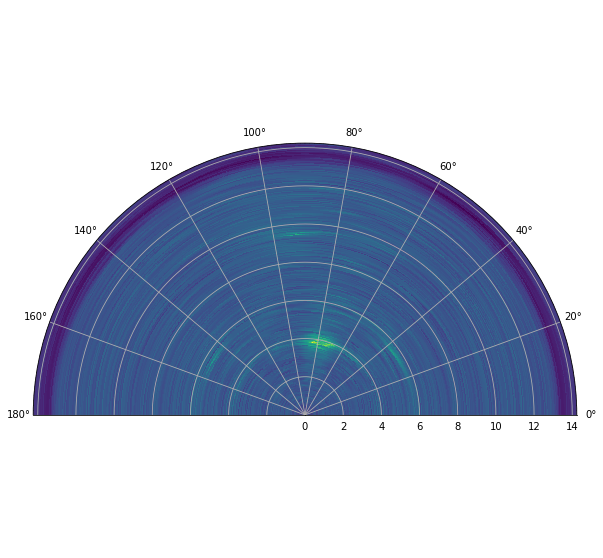

In [6]:
test_radar_frame = radar_frames[random_int]

test_radar_cube = mm.dsp.range_processing(test_radar_frame)
mean = test_radar_cube.mean(0)                 
test_radar_cube = test_radar_cube - mean


(test_log_doppler_cube, test_doppler_cube) = mm.dsp.doppler_processing(test_radar_cube,
                                             num_tx_antennas=iwr_cfg_dict['numTx'], clutter_removal_enabled=False,
                                             interleaved=False, window_type_2d=mm.dsp.utils.Window.HAMMING,
                                             accumulate=False,phase_correction=True)

test_doppler_cube = np.fft.fftshift(test_doppler_cube, axes=(2,))
test_log_doppler_cube = np.fft.fftshift(test_log_doppler_cube, axes=(2,))



plt.figure(figsize=(15,5))
plt.suptitle('Frame %d'%random_int)
plt.subplot(121)
plt.imshow(np.abs(test_doppler_cube[:,0]).T,aspect='auto',origin='lower', 
           extent=[0,304*range_res,-test_log_doppler_cube.shape[2] * dop_res / 2, test_log_doppler_cube.shape[2] * dop_res / 2])
plt.title('Mean-Subtraction Range Doppler')
plt.xlabel('Range (m)')
plt.ylabel('Doppler Vel. (m/s)')
plt.subplot(122)
plt.imshow(images[random_int])
plt.axis('off')
plt.show()

beamforming_result = np.zeros([BINS_PROCESSED,ANGLE_BINS],dtype=np.complex_) # range bins x angle bins


for jj in range(BINS_PROCESSED):
    beamforming_result[jj,:], _ = mm.dsp.aoa_capon(test_doppler_cube[jj], steering_vec)

plt.figure(figsize=(15,10))
plt.tight_layout(True)
plt.subplot(111, projection='polar')
# # cartesian coordinates (looks like real life)
# beamforming_result = np.flip(beamforming_result,axis=1)  # dont know why we need this but we'll be using own polar transform in future
#
azimuths = np.radians(np.linspace(0, 180, 181))
zeniths = np.linspace(0, range_res*BINS_PROCESSED, BINS_PROCESSED)
r, theta = np.meshgrid(zeniths, azimuths)
values = beamforming_result.T
plt.pcolormesh(theta, r, np.log(np.abs(values)))
plt.grid()
plt.xlim([0,np.pi])
plt.show()

#### Zeroing Out Highest Signular Value

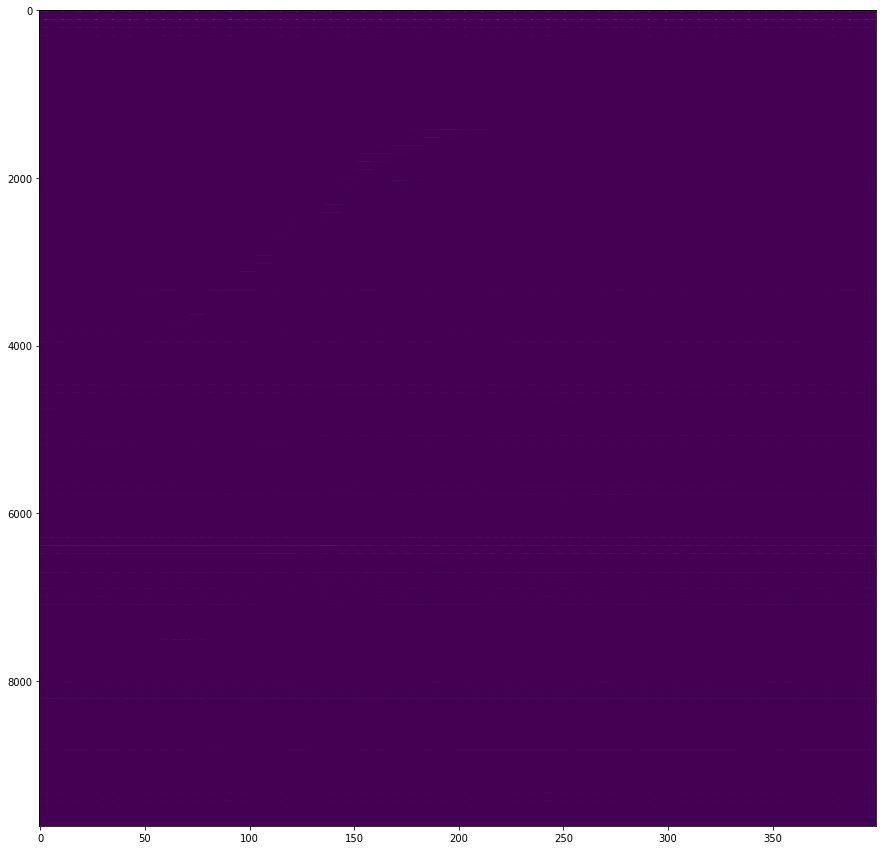

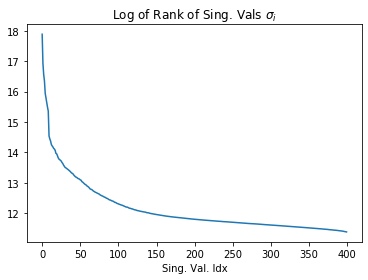

In [10]:
combined_shape = np.array([BINS_PROCESSED*DOPPLER_BINS,len(radar_frames)*VIRT_ANT],dtype=np.int)
combined_mat = np.zeros(combined_shape,dtype=np.complex)

for ii in range(len(radar_frames)):

    test_radar_frame = radar_frames[ii]

    test_radar_cube = mm.dsp.range_processing(test_radar_frame)
    (_, test_doppler_cube) = mm.dsp.doppler_processing(test_radar_cube,
                                                 num_tx_antennas=iwr_cfg_dict['numTx'], clutter_removal_enabled=False,
                                                 interleaved=False, window_type_2d=mm.dsp.utils.Window.HAMMING,
                                                 accumulate=False,phase_correction=True)

    test_doppler_cube = np.fft.fftshift(test_doppler_cube, axes=(2,))
    test_doppler_cube = np.swapaxes(test_doppler_cube,0,1).reshape(VIRT_ANT,-1)
    combined_mat[:,ii*VIRT_ANT:(ii+1)*VIRT_ANT] = test_doppler_cube .T

plt.figure(figsize=(15,15))
plt.imshow(np.abs(combined_mat),aspect='auto')  
plt.show()

radar_frames_array = np.array(radar_frames)
radar_frames_array = np.swapaxes(radar_frames_array,1,2)

radar_frames_array = radar_frames_array.reshape(combined_shape) 
recon = np.zeros(combined_shape,dtype=np.complex)

n = len(radar_frames)*VIRT_ANT
u, s, vh = np.linalg.svd(combined_mat, full_matrices=True)
plt.plot(np.log(s))
plt.title('Log of Rank of Sing. Vals $\sigma_i$')
plt.xlabel('Sing. Val. Idx')
plt.show()

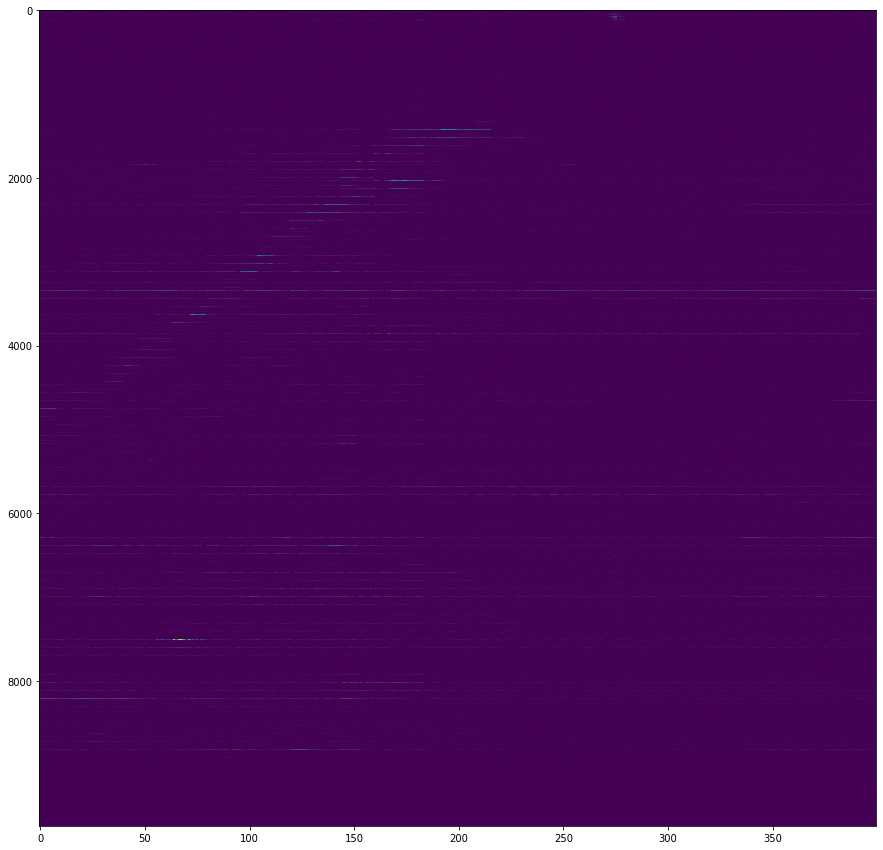

In [11]:
k = 20
s_edit = copy.copy(s)
s_edit[:k] = 0

smat = np.zeros((len(u), n))
smat[:n, :n] = np.diag(s_edit)
# np.allclose(composite, np.dot(u, np.dot(smat, vh)))

recon = np.dot(u, np.dot(smat, vh))
plt.figure(figsize=(15,15))
plt.imshow(np.abs(recon),aspect='auto')  
plt.show()

In [12]:
recon = (recon.T).reshape((len(radar_frames),VIRT_ANT,BINS_PROCESSED,DOPPLER_BINS))

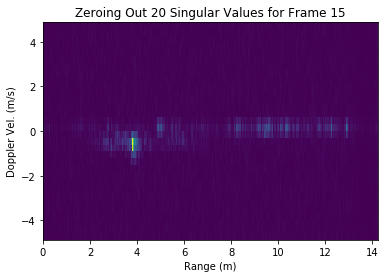

In [13]:
plt.imshow(np.abs(recon[random_int,0]).T,aspect='auto',origin='lower', 
           extent=[0,304*range_res,-test_log_doppler_cube.shape[2] * dop_res / 2, test_log_doppler_cube.shape[2] * dop_res / 2])
plt.title('Zeroing Out %d Singular Values for Frame %d'%(k,random_int))
plt.xlabel('Range (m)')
plt.ylabel('Doppler Vel. (m/s)')
plt.show()

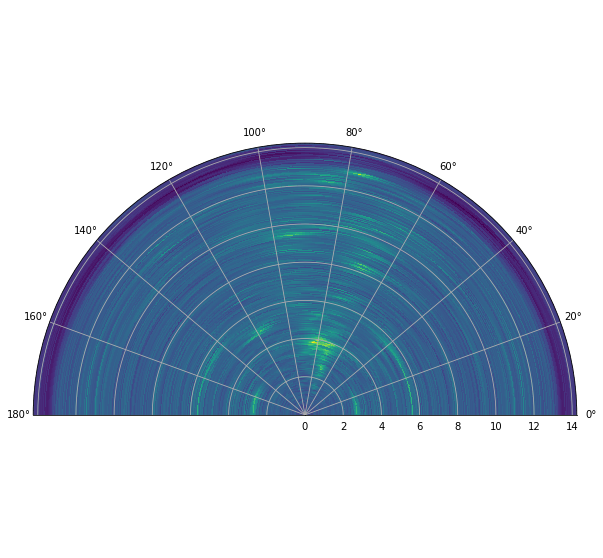

In [14]:
recon = np.swapaxes(recon,1,2)
beamforming_result = np.zeros([BINS_PROCESSED,ANGLE_BINS],dtype=np.complex_) # range bins x angle bins


for jj in range(BINS_PROCESSED):
    beamforming_result[jj,:], _ = mm.dsp.aoa_capon(recon[random_int,jj], steering_vec)

plt.figure(figsize=(15,10))
plt.tight_layout(True)
plt.subplot(111, projection='polar')
# # cartesian coordinates (looks like real life)
# beamforming_result = np.flip(beamforming_result,axis=1)  # dont know why we need this but we'll be using own polar transform in future
#
azimuths = np.radians(np.linspace(0, 180, 181))
zeniths = np.linspace(0, range_res*BINS_PROCESSED, BINS_PROCESSED)
r, theta = np.meshgrid(zeniths, azimuths)
values = beamforming_result.T
plt.pcolormesh(theta, r, np.log(np.abs(values)))
plt.grid()
plt.xlim([0,np.pi])
plt.show()

#### RPCA with Complex Numbers

This version of RPCA accomidates complex inputs. The modification lies in how we shrink the sparse component.

The orginal shrinkage step is:
$\mathcal{S}_\tau(x) = \text{sgn}(x)\text{max}(|x|-\tau,0)$

The modified version becomes: $\mathcal{S}_\tau(x) = \text{max}(1-\frac{\tau}{||x||_2},0)x$

NOTE: Need Lipschitz Constant for proper shrinkage contant

In [88]:
L_pcp, S_pcp, _ = complex_pcp(combined_mat, verbose=True, maxiter=50,L_f = 1)

mu = 5.925478405322467e-05
Iteration 0: error=2.028e-04-3.327e-05j, rank=400, nnz=466290, time=6.037e-01
Iteration 1: error=3.741e-06-5.692e-06j, rank=400, nnz=524377, time=5.210e-01
Iteration 2: error=2.290e-06-3.844e-06j, rank=400, nnz=557416, time=5.120e-01
Iteration 3: error=1.005e-06-4.209e-06j, rank=400, nnz=588151, time=5.413e-01
Iteration 4: error=8.787e-07-4.528e-06j, rank=400, nnz=618402, time=5.349e-01
Iteration 5: error=1.584e-06-3.975e-06j, rank=400, nnz=648185, time=5.200e-01
Iteration 6: error=1.259e-06-4.050e-06j, rank=400, nnz=677151, time=5.424e-01
Iteration 7: error=5.389e-07-3.569e-06j, rank=400, nnz=705676, time=6.287e-01
Iteration 8: error=2.119e-07-1.705e-06j, rank=400, nnz=733730, time=5.022e-01
Iteration 9: error=2.495e-06-1.521e-08j, rank=400, nnz=761205, time=5.051e-01
Iteration 10: error=2.574e-06+4.925e-06j, rank=400, nnz=787887, time=6.082e-01
Iteration 11: error=6.475e-07+2.059e-06j, rank=400, nnz=813974, time=5.995e-01
Iteration 12: error=4.070e-06+4.576

Iteration 49: error=7.588e-07-1.409e-06j, rank=400, nnz=1426683, time=4.903e-01


In [89]:
L_pcp = (L_pcp.T).reshape((len(radar_frames),VIRT_ANT,BINS_PROCESSED,DOPPLER_BINS))
S_pcp = (S_pcp.T).reshape((len(radar_frames),VIRT_ANT,BINS_PROCESSED,DOPPLER_BINS))

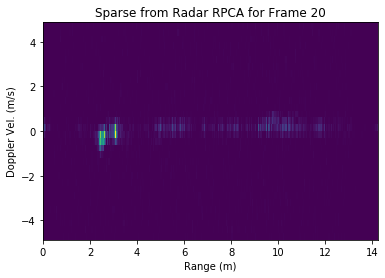

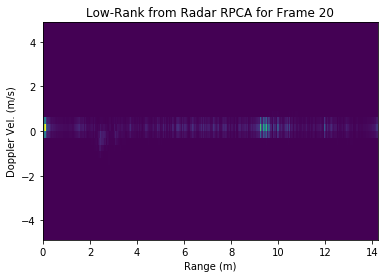

In [90]:
plt.imshow(np.abs(S_pcp[random_int,0]).T,aspect='auto',origin='lower', 
           extent=[0,304*range_res,-test_log_doppler_cube.shape[2] * dop_res / 2, test_log_doppler_cube.shape[2] * dop_res / 2])
plt.title('Sparse from Radar RPCA for Frame %d'%(random_int))
plt.xlabel('Range (m)')
plt.ylabel('Doppler Vel. (m/s)')
plt.show()

plt.imshow(np.abs(L_pcp[random_int,0]).T,aspect='auto',origin='lower', 
           extent=[0,304*range_res,-test_log_doppler_cube.shape[2] * dop_res / 2, test_log_doppler_cube.shape[2] * dop_res / 2])
plt.title('Low-Rank from Radar RPCA for Frame %d'%(random_int))
plt.xlabel('Range (m)')
plt.ylabel('Doppler Vel. (m/s)')
plt.show()

In [91]:
S_pcp = np.swapaxes(S_pcp,1,2)
beamforming_result = np.zeros([BINS_PROCESSED,ANGLE_BINS],dtype=np.complex_) # range bins x angle bins

L_pcp = np.swapaxes(L_pcp,1,2)
beamforming_result = np.zeros([BINS_PROCESSED,ANGLE_BINS],dtype=np.complex_) # range bins x angle bins

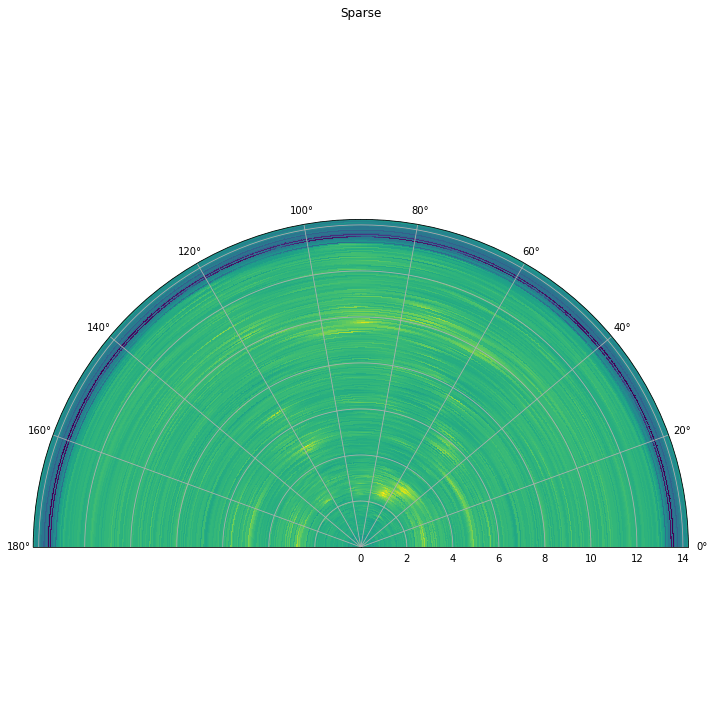

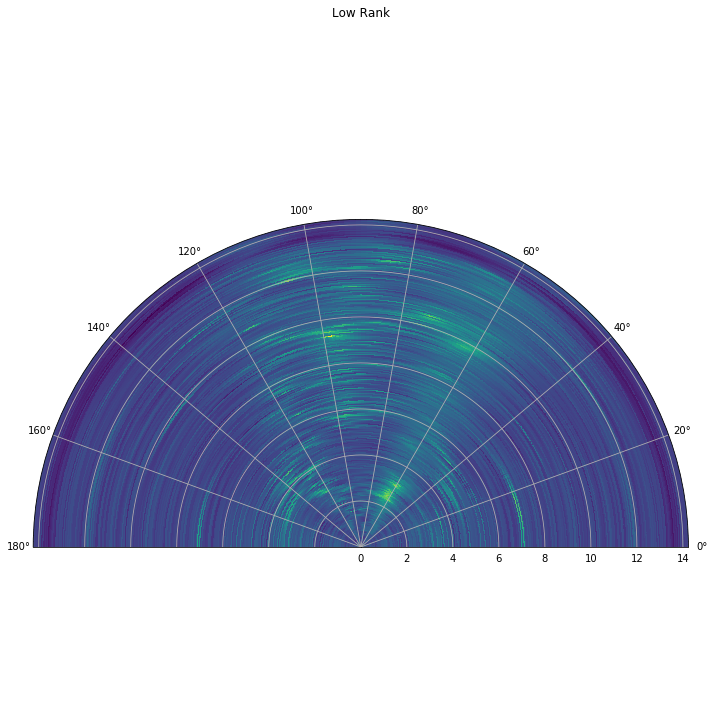

In [92]:
for jj in range(BINS_PROCESSED):
    beamforming_result[jj,:], _ = mm.dsp.aoa_capon(S_pcp[random_int,jj], steering_vec)

plt.figure(figsize=(15,10))
plt.subplot(111, projection='polar')

# # cartesian coordinates (looks like real life)
# beamforming_result = np.flip(beamforming_result,axis=1)  # dont know why we need this but we'll be using own polar transform in future
#
azimuths = np.radians(np.linspace(0, 180, 181))
zeniths = np.linspace(0, range_res*BINS_PROCESSED, BINS_PROCESSED)
r, theta = np.meshgrid(zeniths, azimuths)
values = beamforming_result.T
plt.pcolormesh(theta, r, np.log(np.abs(values)))
plt.grid()
plt.xlim([0,np.pi])
plt.title('Sparse')
plt.tight_layout()
plt.show()


for jj in range(BINS_PROCESSED):
    beamforming_result[jj,:], _ = mm.dsp.aoa_capon(L_pcp[random_int,jj], steering_vec)

plt.figure(figsize=(15,10))
plt.subplot(111, projection='polar')
azimuths = np.radians(np.linspace(0, 180, 181))
zeniths = np.linspace(0, range_res*BINS_PROCESSED, BINS_PROCESSED)
r, theta = np.meshgrid(zeniths, azimuths)
values = beamforming_result.T
plt.pcolormesh(theta, r, np.log(np.abs(values)))
plt.grid()
plt.xlim([0,np.pi])
plt.title('Low Rank')
plt.tight_layout()
plt.show()

## Target Clustering

## Determining Bounds

Let's assume the mean subtraction method is used here.

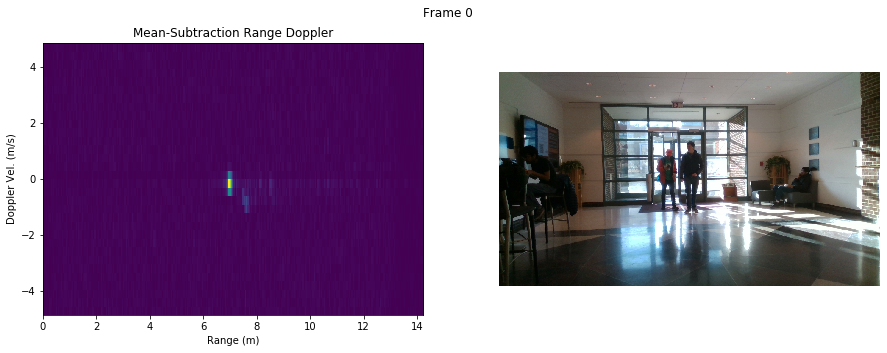

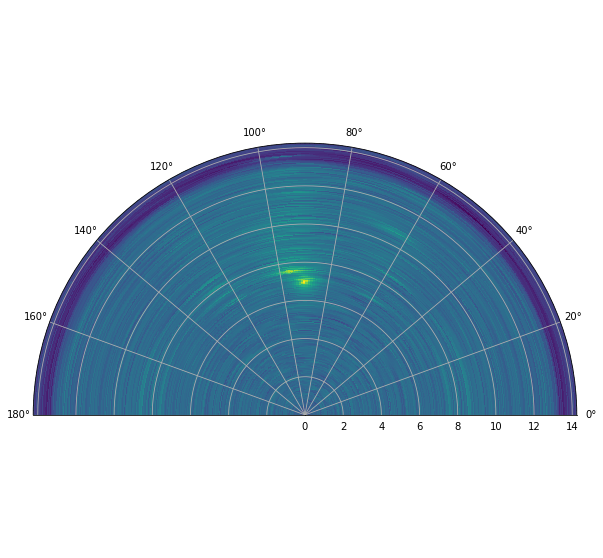

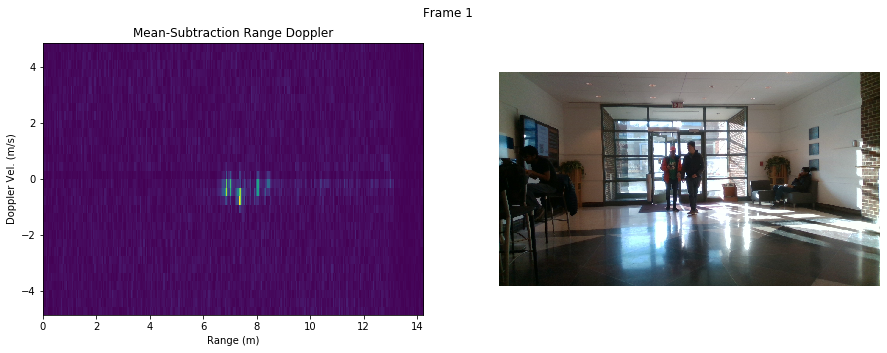

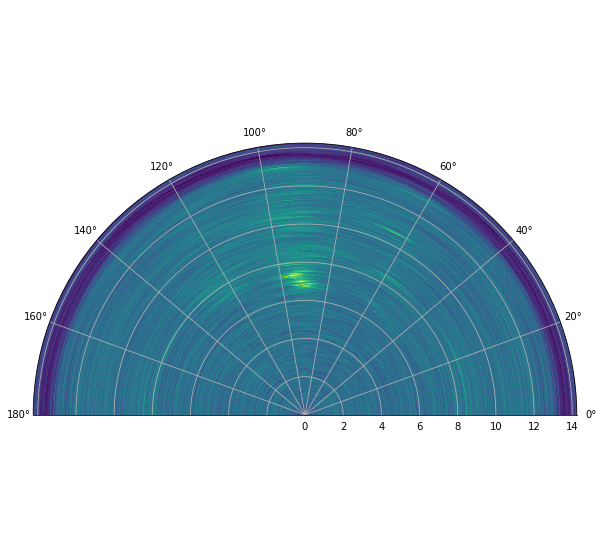

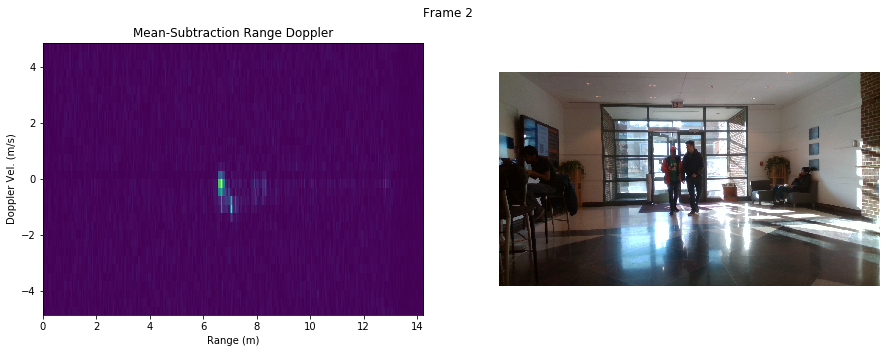

...

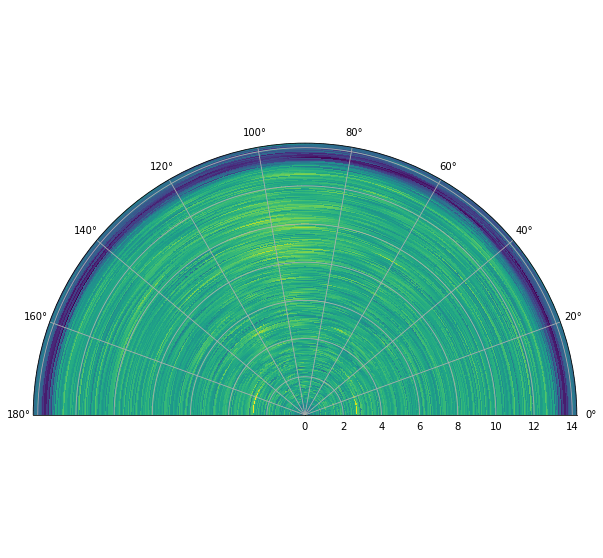

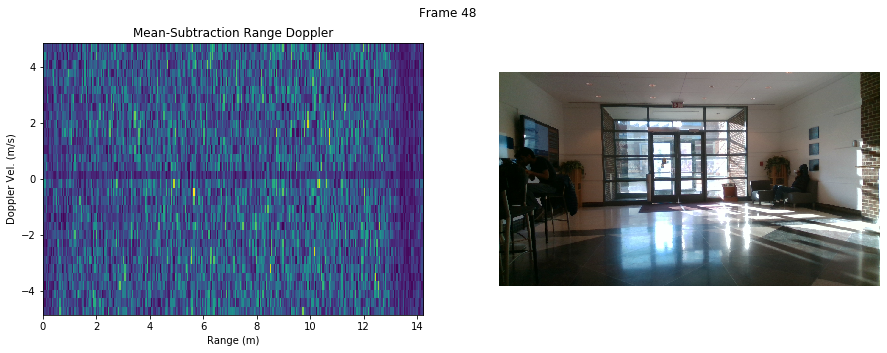

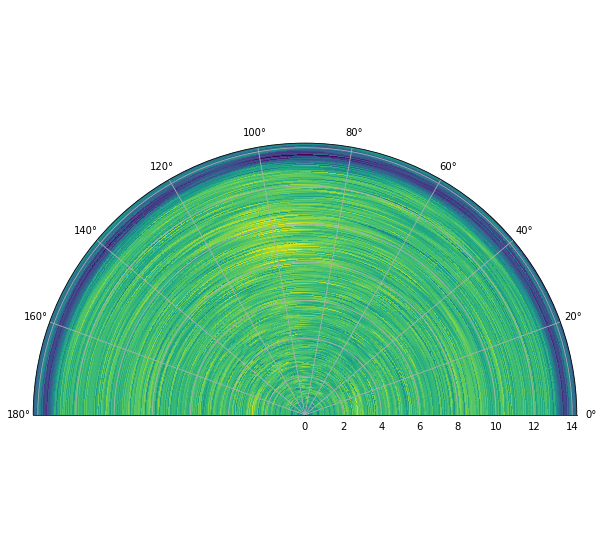

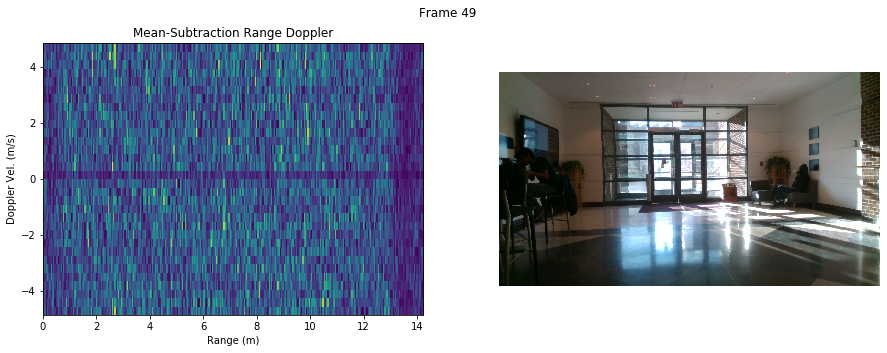

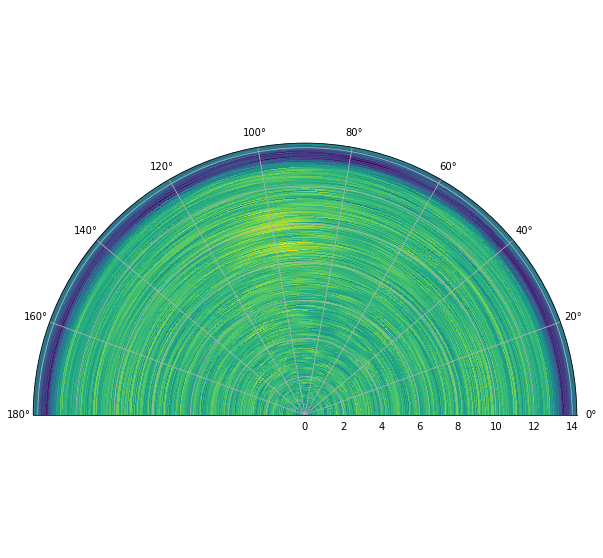

In [6]:
radar_range_azs = []
for ii in range(len(radar_frames)):
    test_radar_frame = radar_frames[ii]
    test_radar_cube = mm.dsp.range_processing(test_radar_frame)
    mean = test_radar_cube.mean(0)                 
    test_radar_cube = test_radar_cube - mean


    (test_log_doppler_cube, test_doppler_cube) = mm.dsp.doppler_processing(test_radar_cube,
                                                 num_tx_antennas=iwr_cfg_dict['numTx'], clutter_removal_enabled=False,
                                                 interleaved=False, window_type_2d=mm.dsp.utils.Window.HAMMING,
                                                 accumulate=False,phase_correction=True)

    test_doppler_cube = np.fft.fftshift(test_doppler_cube, axes=(2,))
    test_log_doppler_cube = np.fft.fftshift(test_log_doppler_cube, axes=(2,))



    plt.figure(figsize=(15,5))
    plt.suptitle('Frame %d'%ii)
    plt.subplot(121)
    plt.imshow(np.abs(test_doppler_cube[:,0]).T,aspect='auto',origin='lower', 
               extent=[0,304*range_res,-test_log_doppler_cube.shape[2] * dop_res / 2, test_log_doppler_cube.shape[2] * dop_res / 2])
    plt.title('Mean-Subtraction Range Doppler')
    plt.xlabel('Range (m)')
    plt.ylabel('Doppler Vel. (m/s)')
    plt.subplot(122)
    plt.imshow(images[ii])
    plt.axis('off')
    plt.show()

    beamforming_result = np.zeros([BINS_PROCESSED,ANGLE_BINS],dtype=np.complex_) # range bins x angle bins


    for jj in range(BINS_PROCESSED):
        beamforming_result[jj,:], _ = mm.dsp.aoa_capon(test_doppler_cube[jj], steering_vec)

    radar_range_azs.append(np.flip(beamforming_result,axis=1))
    plt.figure(figsize=(15,10))
    plt.tight_layout(True)
    plt.subplot(111, projection='polar')
    # # cartesian coordinates (looks like real life)
    # beamforming_result = np.flip(beamforming_result,axis=1)  # dont know why we need this but we'll be using own polar transform in future
    #
    azimuths = np.radians(np.linspace(0, 180, 181))
    zeniths = np.linspace(0, range_res*BINS_PROCESSED, BINS_PROCESSED)
    r, theta = np.meshgrid(zeniths, azimuths)
    values = beamforming_result.T
    plt.pcolormesh(theta, r, np.log(np.abs(values)))
    plt.grid()
    plt.xlim([0,np.pi])
    plt.show()

In [7]:
radar_az_amps = [np.sum(np.abs(r_a),axis=0) for r_a in radar_range_azs] 
radar_az_log_amps = [np.log(a_a) for a_a in radar_az_amps]

In [8]:
# determine FOV in deg
right = images[0].shape[1]
left = 0


print('Left Min Angle', 180/np.pi*np.arctan((left-x_c)/fx))
print('Right Max Angle', 180/np.pi*np.arctan((right-x_c)/fx))


pixel_angles = 180/np.pi*np.arctan((np.arange(right)-x_c)/fx)
front_angles = np.arange(-90,91)

Left Min Angle -35.16107322153295
Right Max Angle 34.346996918680944


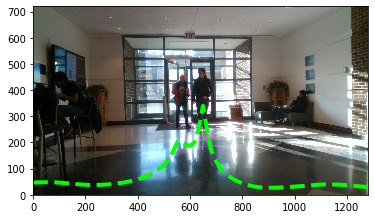

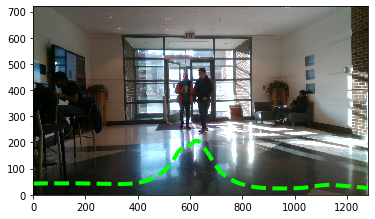

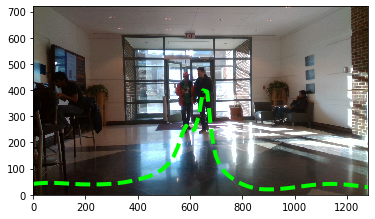

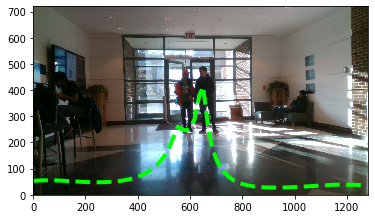

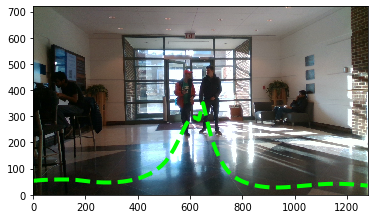

...

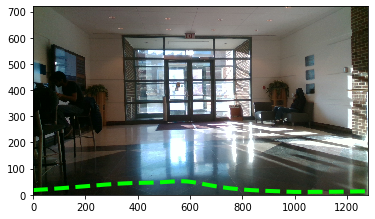

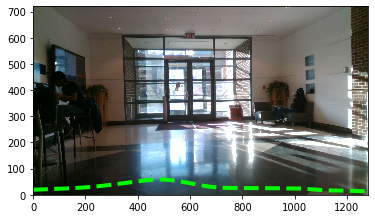

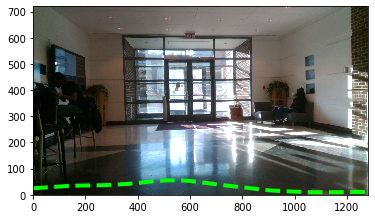

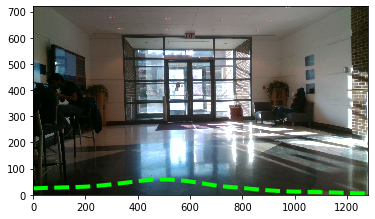

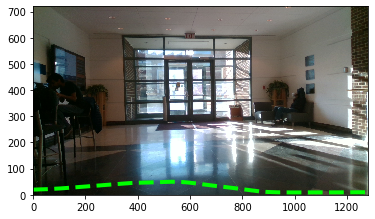

In [9]:
front_angles = np.arange(-90,91)
pixel_amplitudes = []

for frame_idx in range(len(radar_az_amps)):
    radar_az_log_amp = radar_az_log_amps[frame_idx]
    
    f = interpolate.interp1d(front_angles,radar_az_log_amp)
    pixel_amps = f(pixel_angles)-np.min(radar_az_log_amps)
    pixel_amplitudes.append(pixel_amps)
    plt.imshow(images[frame_idx],extent=[0,1280,0,720])
    plt.plot((pixel_amps)*200,'--',c='lime',linewidth=4)
#     plt.plot(pixel_angles,pixel_amps-log_amps_mean)
    plt.show()
    
    
    

In [32]:
# because high prob should have low cost for M_F

l_bound = 3
u_bound = .5

pixel_amplitudes -= np.min(pixel_amplitudes)
pixel_amplitudes /= np.max(pixel_amplitudes)
pixel_cost_amplitudes = pixel_amplitudes * (u_bound-l_bound) + l_bound

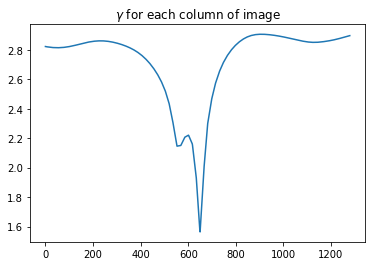

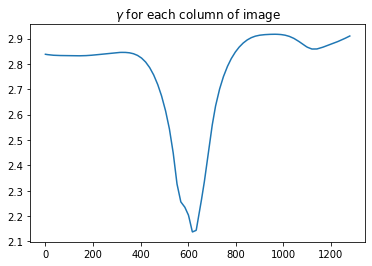

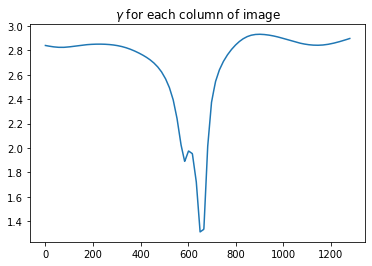

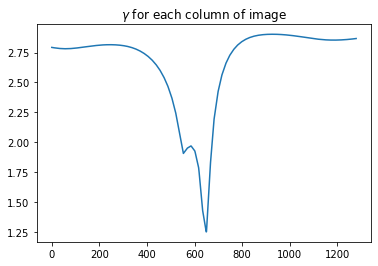

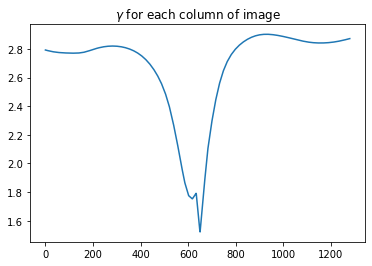

...

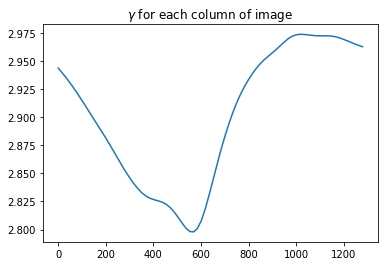

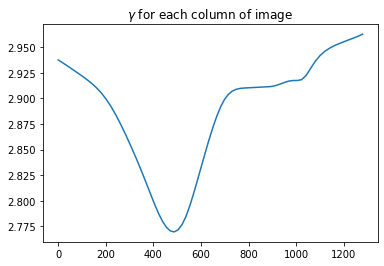

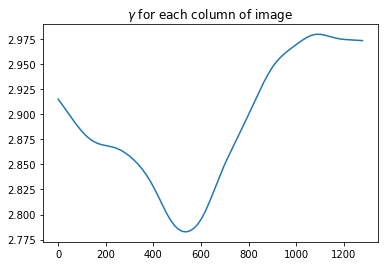

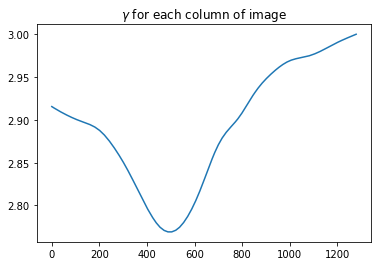

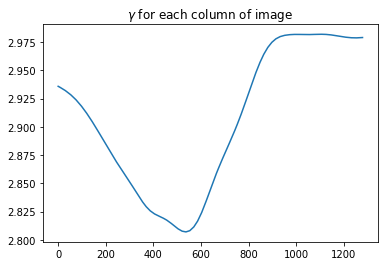

In [33]:
for ii in pixel_cost_amplitudes:
    plt.plot(ii)
    plt.title('$\gamma$ for each column of image')
    plt.show()

In [34]:
M_F = pixel_cost_amplitudes[:,:,np.newaxis] * np.ones((images.shape[0],images.shape[2],images.shape[1]))
M_F = np.swapaxes(M_F,1,2).reshape(images.shape[0],-1)
M_F = M_F.T

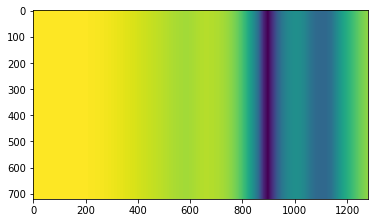

In [35]:
plt.imshow(M_F[:,18].reshape(720,-1))

## RPCA

In [36]:
def rgb2gray(rgb):
    return np.dot(rgb[...,:3], [0.2989, 0.5870, 0.1140])
images_bw = np.array([rgb2gray(image) for image in images])

In [37]:
D = images_bw.reshape(images_bw.shape[0], -1).T

In [38]:
images.shape

(50, 720, 1280, 4)

mu = 0.0024706205892880513
Iteration 0: error=1.978e-03, rank=50, nnz=4299687, time=1.888e+00


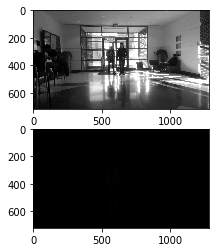

Iteration 1: error=1.828e-04, rank=50, nnz=5165771, time=1.791e+00
Iteration 2: error=1.159e-04, rank=50, nnz=5733003, time=1.723e+00
Iteration 3: error=1.048e-04, rank=50, nnz=6252076, time=1.726e+00
Iteration 4: error=1.011e-04, rank=50, nnz=6757234, time=1.721e+00
Iteration 5: error=9.838e-05, rank=50, nnz=7248513, time=1.720e+00
Iteration 6: error=9.591e-05, rank=50, nnz=7722199, time=1.742e+00
Iteration 7: error=9.352e-05, rank=50, nnz=8178223, time=1.727e+00
Iteration 8: error=9.115e-05, rank=50, nnz=8617675, time=8.151e+00
Iteration 9: error=8.877e-05, rank=50, nnz=9036841, time=1.778e+00
Iteration 10: error=8.633e-05, rank=50, nnz=9439811, time=1.704e+00
Iteration 11: error=8.406e-05, rank=50, nnz=9824477, time=1.703e+00
Iteration 12: error=8.183e-05, rank=50, nnz=10191233, time=1.707e+00
Iteration 13: error=8.000e-05, rank=50, nnz=10541391, time=1.704e+00
Iteration 14: error=7.850e-05, rank=50, nnz=10876323, time=1.712e+00
Iteration 15: error=7.719e-05, rank=50, nnz=11198985, 

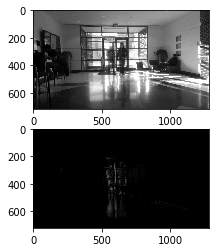

Iteration 21: error=7.327e-05, rank=50, nnz=12885729, time=1.712e+00
Iteration 22: error=7.303e-05, rank=50, nnz=13131495, time=1.709e+00
Iteration 23: error=7.276e-05, rank=50, nnz=13369740, time=1.705e+00
Iteration 24: error=7.244e-05, rank=50, nnz=13601710, time=1.712e+00
Iteration 25: error=7.205e-05, rank=50, nnz=13827094, time=1.711e+00
Iteration 26: error=7.131e-05, rank=48, nnz=14044550, time=3.761e+00
Iteration 27: error=7.038e-05, rank=46, nnz=14255665, time=1.704e+00
Iteration 28: error=6.951e-05, rank=44, nnz=14452651, time=1.703e+00
Iteration 29: error=6.837e-05, rank=41, nnz=14635678, time=1.704e+00
Iteration 30: error=6.761e-05, rank=40, nnz=14805882, time=1.711e+00
Iteration 31: error=6.686e-05, rank=38, nnz=14967738, time=1.707e+00
Iteration 32: error=6.578e-05, rank=36, nnz=15120206, time=1.708e+00
Iteration 33: error=7.749e-05, rank=34, nnz=15269638, time=3.066e+00
Iteration 34: error=7.597e-05, rank=32, nnz=15416808, time=3.515e+00
Iteration 35: error=8.158e-05, ran

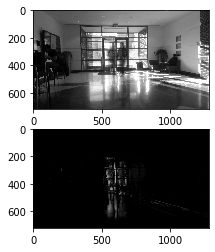

Iteration 41: error=6.958e-05, rank=28, nnz=16350222, time=6.356e+00
Iteration 42: error=7.132e-05, rank=28, nnz=16470388, time=2.922e+00
Iteration 43: error=1.003e-04, rank=27, nnz=16600954, time=2.788e+00
Iteration 44: error=8.311e-05, rank=28, nnz=16721107, time=2.977e+00
Iteration 45: error=7.785e-05, rank=28, nnz=16841173, time=3.021e+00
Iteration 46: error=7.385e-05, rank=27, nnz=16954490, time=3.511e+00
Iteration 47: error=7.566e-05, rank=27, nnz=17068195, time=3.874e+00
Iteration 48: error=8.401e-05, rank=27, nnz=17192675, time=6.457e+00
Iteration 49: error=7.792e-05, rank=28, nnz=17309454, time=4.247e+00
Iteration 50: error=7.044e-05, rank=28, nnz=17427788, time=3.805e+00
Iteration 51: error=6.744e-05, rank=28, nnz=17544675, time=7.231e+00
Iteration 52: error=7.126e-05, rank=28, nnz=17654842, time=3.255e+00
Iteration 53: error=7.173e-05, rank=27, nnz=17761725, time=3.104e+00
Iteration 54: error=7.305e-05, rank=26, nnz=17868925, time=3.275e+00
Iteration 55: error=9.696e-05, ran

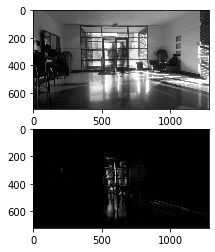

Iteration 61: error=7.882e-05, rank=26, nnz=18597585, time=3.249e+00
Iteration 62: error=7.475e-05, rank=26, nnz=18686973, time=4.461e+00
Iteration 63: error=7.961e-05, rank=25, nnz=18779399, time=3.225e+00
Iteration 64: error=8.626e-05, rank=25, nnz=18868958, time=2.806e+00
Iteration 65: error=1.037e-04, rank=25, nnz=18971006, time=2.781e+00
Iteration 66: error=9.410e-05, rank=24, nnz=19078236, time=2.805e+00
Iteration 67: error=1.120e-04, rank=25, nnz=19185950, time=2.773e+00
Iteration 68: error=8.918e-05, rank=25, nnz=19269897, time=2.957e+00
Iteration 69: error=7.542e-05, rank=25, nnz=19343634, time=3.173e+00
Iteration 70: error=8.469e-05, rank=24, nnz=19414757, time=3.086e+00
Iteration 71: error=8.005e-05, rank=24, nnz=19494540, time=2.906e+00
Iteration 72: error=7.262e-05, rank=23, nnz=19558194, time=3.382e+00
Iteration 73: error=7.648e-05, rank=24, nnz=19619093, time=3.419e+00
Iteration 74: error=7.789e-05, rank=23, nnz=19680044, time=2.874e+00
Iteration 75: error=7.400e-05, ran

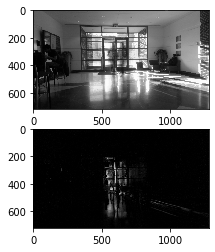

Iteration 81: error=8.241e-05, rank=23, nnz=20103189, time=3.250e+00
Iteration 82: error=7.682e-05, rank=23, nnz=20158085, time=3.384e+00
Iteration 83: error=7.099e-05, rank=23, nnz=20205513, time=3.046e+00
Iteration 84: error=7.456e-05, rank=22, nnz=20258942, time=3.855e+00
Iteration 85: error=9.911e-05, rank=22, nnz=20319329, time=3.145e+00
Iteration 86: error=7.531e-05, rank=22, nnz=20363537, time=2.901e+00
Iteration 87: error=8.345e-05, rank=21, nnz=20420887, time=2.748e+00
Iteration 88: error=8.178e-05, rank=22, nnz=20473678, time=2.496e+00
Iteration 89: error=8.145e-05, rank=22, nnz=20522051, time=2.575e+00
Iteration 90: error=9.023e-05, rank=22, nnz=20581403, time=2.467e+00
Iteration 91: error=8.447e-05, rank=22, nnz=20649533, time=2.465e+00
Iteration 92: error=7.757e-05, rank=22, nnz=20686335, time=2.449e+00
Iteration 93: error=7.401e-05, rank=21, nnz=20734960, time=2.479e+00
Iteration 94: error=7.226e-05, rank=20, nnz=20781096, time=2.485e+00
Iteration 95: error=8.735e-05, ran

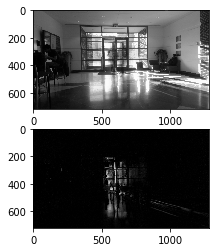

Iteration 101: error=7.141e-05, rank=20, nnz=21099174, time=2.808e+00
Iteration 102: error=7.065e-05, rank=20, nnz=21139365, time=2.439e+00
Iteration 103: error=7.396e-05, rank=20, nnz=21181616, time=2.587e+00
Iteration 104: error=8.242e-05, rank=20, nnz=21229123, time=2.443e+00
Iteration 105: error=7.375e-05, rank=19, nnz=21266198, time=2.434e+00
Iteration 106: error=7.345e-05, rank=19, nnz=21307132, time=2.106e+00
Iteration 107: error=7.379e-05, rank=20, nnz=21346460, time=2.183e+00
Iteration 108: error=7.639e-05, rank=20, nnz=21381113, time=2.721e+00
Iteration 109: error=7.524e-05, rank=19, nnz=21418256, time=2.343e+00
Iteration 110: error=6.057e-05, rank=19, nnz=21459921, time=2.156e+00
Iteration 111: error=6.758e-05, rank=18, nnz=21499805, time=2.099e+00
Iteration 112: error=7.884e-05, rank=19, nnz=21532706, time=2.096e+00
Iteration 113: error=7.257e-05, rank=19, nnz=21577816, time=2.139e+00
Iteration 114: error=7.136e-05, rank=19, nnz=21622202, time=2.204e+00
Iteration 115: error

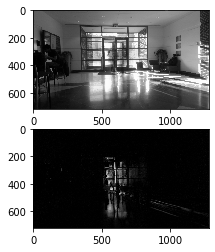

Iteration 121: error=6.940e-05, rank=19, nnz=21879028, time=2.564e+00
Iteration 122: error=7.280e-05, rank=17, nnz=21912082, time=2.364e+00
Iteration 123: error=7.888e-05, rank=18, nnz=21947382, time=1.849e+00
Iteration 124: error=6.803e-05, rank=18, nnz=21985171, time=2.029e+00
Iteration 125: error=6.844e-05, rank=18, nnz=22019684, time=2.187e+00
Iteration 126: error=5.848e-05, rank=18, nnz=22043318, time=2.117e+00
Iteration 127: error=5.975e-05, rank=19, nnz=22075577, time=2.024e+00
Iteration 128: error=5.735e-05, rank=18, nnz=22105059, time=2.220e+00
Iteration 129: error=6.283e-05, rank=18, nnz=22133564, time=2.286e+00
Iteration 130: error=6.542e-05, rank=18, nnz=22162291, time=2.524e+00
Iteration 131: error=7.369e-05, rank=18, nnz=22184481, time=2.696e+00
Iteration 132: error=6.987e-05, rank=17, nnz=22213361, time=2.255e+00
Iteration 133: error=9.617e-05, rank=17, nnz=22252605, time=2.133e+00
Iteration 134: error=7.436e-05, rank=17, nnz=22274474, time=3.247e+00
Iteration 135: error

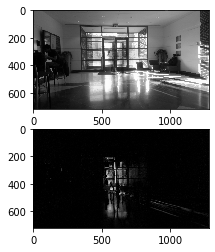

Iteration 141: error=6.465e-05, rank=16, nnz=22466591, time=2.032e+00
Iteration 142: error=7.486e-05, rank=17, nnz=22509232, time=1.815e+00
Iteration 143: error=8.329e-05, rank=16, nnz=22532198, time=1.950e+00
Iteration 144: error=8.133e-05, rank=16, nnz=22564595, time=1.958e+00
Iteration 145: error=8.070e-05, rank=15, nnz=22594781, time=2.118e+00
Iteration 146: error=7.880e-05, rank=16, nnz=22623848, time=1.951e+00
Iteration 147: error=7.555e-05, rank=16, nnz=22654055, time=1.993e+00
Iteration 148: error=7.196e-05, rank=16, nnz=22676581, time=1.764e+00
Iteration 149: error=5.943e-05, rank=15, nnz=22701563, time=1.694e+00
Iteration 150: error=5.704e-05, rank=16, nnz=22713359, time=1.665e+00
Iteration 151: error=5.849e-05, rank=15, nnz=22727153, time=2.090e+00
Iteration 152: error=5.751e-05, rank=15, nnz=22733664, time=1.739e+00
Iteration 153: error=5.590e-05, rank=16, nnz=22741735, time=1.664e+00
Iteration 154: error=6.419e-05, rank=16, nnz=22755999, time=1.910e+00
Iteration 155: error

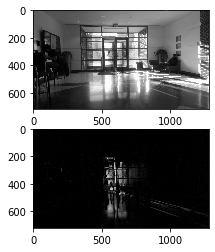

Iteration 161: error=6.962e-05, rank=16, nnz=22862152, time=2.373e+00
Iteration 162: error=7.129e-05, rank=16, nnz=22878551, time=2.184e+00
Iteration 163: error=7.587e-05, rank=16, nnz=22897080, time=2.052e+00
Iteration 164: error=7.447e-05, rank=15, nnz=22914523, time=2.005e+00
Iteration 165: error=6.406e-05, rank=15, nnz=22931229, time=1.858e+00
Iteration 166: error=7.612e-05, rank=15, nnz=22950838, time=1.991e+00
Iteration 167: error=6.742e-05, rank=14, nnz=22974104, time=2.424e+00
Iteration 168: error=6.913e-05, rank=15, nnz=22996408, time=2.025e+00
Iteration 169: error=5.726e-05, rank=15, nnz=23023309, time=2.043e+00
Iteration 170: error=5.412e-05, rank=15, nnz=23036266, time=1.934e+00
Iteration 171: error=4.839e-05, rank=14, nnz=23056732, time=1.871e+00
Iteration 172: error=4.602e-05, rank=13, nnz=23065947, time=1.700e+00
Iteration 173: error=4.782e-05, rank=13, nnz=23074888, time=1.556e+00
Iteration 174: error=4.455e-05, rank=14, nnz=23083849, time=1.506e+00
Iteration 175: error

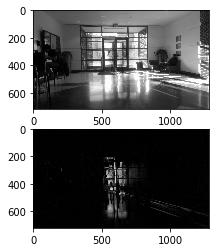

Iteration 181: error=4.029e-05, rank=13, nnz=23125093, time=1.477e+00
Iteration 182: error=4.718e-05, rank=13, nnz=23131749, time=1.524e+00
Iteration 183: error=4.177e-05, rank=13, nnz=23136835, time=1.512e+00
Iteration 184: error=4.350e-05, rank=13, nnz=23144329, time=1.498e+00
Iteration 185: error=4.804e-05, rank=12, nnz=23151557, time=1.465e+00
Iteration 186: error=4.457e-05, rank=13, nnz=23158231, time=1.358e+00
Iteration 187: error=4.275e-05, rank=14, nnz=23166122, time=1.486e+00
Iteration 188: error=3.793e-05, rank=14, nnz=23172584, time=1.594e+00
Iteration 189: error=4.386e-05, rank=13, nnz=23172842, time=1.574e+00
Iteration 190: error=4.091e-05, rank=13, nnz=23178997, time=1.469e+00
Iteration 191: error=4.154e-05, rank=14, nnz=23183109, time=1.464e+00
Iteration 192: error=4.145e-05, rank=13, nnz=23191751, time=1.570e+00
Iteration 193: error=4.109e-05, rank=13, nnz=23197423, time=1.423e+00
Iteration 194: error=5.071e-05, rank=13, nnz=23197476, time=1.444e+00
Iteration 195: error

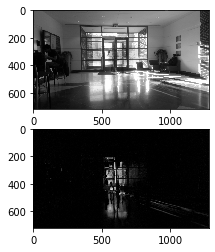

Iteration 201: error=7.276e-05, rank=13, nnz=23234242, time=1.497e+00
Iteration 202: error=5.813e-05, rank=13, nnz=23242008, time=1.549e+00
Iteration 203: error=6.229e-05, rank=12, nnz=23254137, time=1.547e+00
Iteration 204: error=9.708e-05, rank=12, nnz=23248850, time=1.387e+00
Iteration 205: error=6.577e-05, rank=13, nnz=23277427, time=1.355e+00
Iteration 206: error=7.488e-05, rank=13, nnz=23286587, time=1.522e+00
Iteration 207: error=6.588e-05, rank=13, nnz=23298724, time=1.512e+00
Iteration 208: error=6.252e-05, rank=13, nnz=23311161, time=1.489e+00
Iteration 209: error=6.026e-05, rank=13, nnz=23322832, time=1.465e+00
Iteration 210: error=5.210e-05, rank=13, nnz=23333760, time=1.488e+00
Iteration 211: error=4.893e-05, rank=14, nnz=23338294, time=1.484e+00
Iteration 212: error=4.684e-05, rank=12, nnz=23344909, time=1.599e+00
Iteration 213: error=5.498e-05, rank=13, nnz=23343475, time=1.357e+00
Iteration 214: error=4.986e-05, rank=13, nnz=23350813, time=1.727e+00
Iteration 215: error

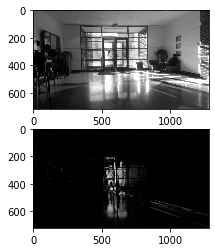

Iteration 221: error=4.938e-05, rank=12, nnz=23379417, time=1.491e+00
Iteration 222: error=4.295e-05, rank=12, nnz=23389866, time=1.388e+00
Iteration 223: error=5.500e-05, rank=12, nnz=23384079, time=1.394e+00
Iteration 224: error=4.912e-05, rank=13, nnz=23391505, time=1.353e+00
Iteration 225: error=4.265e-05, rank=13, nnz=23402479, time=1.462e+00
Iteration 226: error=4.423e-05, rank=13, nnz=23406417, time=1.486e+00
Iteration 227: error=4.084e-05, rank=13, nnz=23412085, time=1.485e+00
Iteration 228: error=4.077e-05, rank=12, nnz=23415106, time=1.455e+00
Iteration 229: error=4.387e-05, rank=12, nnz=23415333, time=1.310e+00
Iteration 230: error=4.194e-05, rank=12, nnz=23421426, time=1.330e+00
Iteration 231: error=5.116e-05, rank=12, nnz=23417470, time=1.328e+00
Iteration 232: error=4.607e-05, rank=12, nnz=23427638, time=1.314e+00
Iteration 233: error=5.631e-05, rank=13, nnz=23423187, time=1.328e+00
Iteration 234: error=4.950e-05, rank=12, nnz=23433515, time=1.459e+00
Iteration 235: error

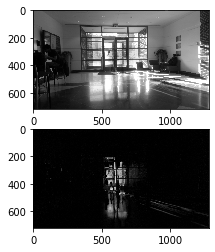

Iteration 241: error=5.082e-05, rank=12, nnz=23465695, time=1.309e+00
Iteration 242: error=5.254e-05, rank=13, nnz=23466215, time=1.294e+00
Iteration 243: error=6.022e-05, rank=12, nnz=23461056, time=1.430e+00
Iteration 244: error=4.983e-05, rank=13, nnz=23471778, time=1.301e+00
Iteration 245: error=5.004e-05, rank=12, nnz=23482094, time=1.414e+00
Iteration 246: error=4.865e-05, rank=12, nnz=23489504, time=1.308e+00
Iteration 247: error=4.820e-05, rank=12, nnz=23495054, time=1.299e+00
Iteration 248: error=4.539e-05, rank=11, nnz=23502909, time=1.287e+00
Iteration 249: error=4.800e-05, rank=11, nnz=23513664, time=1.207e+00
Iteration 250: error=3.901e-05, rank=11, nnz=23524793, time=1.230e+00
Iteration 251: error=3.871e-05, rank=11, nnz=23525313, time=1.240e+00
Iteration 252: error=3.680e-05, rank=11, nnz=23530456, time=1.229e+00
Iteration 253: error=3.849e-05, rank=12, nnz=23528113, time=1.251e+00
Iteration 254: error=3.523e-05, rank=12, nnz=23528328, time=1.360e+00
Iteration 255: error

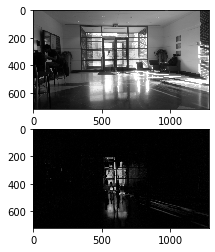

Iteration 261: error=3.615e-05, rank=12, nnz=23537966, time=1.300e+00
Iteration 262: error=3.662e-05, rank=12, nnz=23538307, time=1.283e+00
Iteration 263: error=3.131e-05, rank=12, nnz=23540536, time=1.289e+00
Iteration 264: error=3.509e-05, rank=12, nnz=23535507, time=1.297e+00
Iteration 265: error=4.106e-05, rank=12, nnz=23533365, time=1.270e+00
Iteration 266: error=3.343e-05, rank=12, nnz=23537787, time=1.295e+00
Iteration 267: error=4.339e-05, rank=12, nnz=23534321, time=1.301e+00
Iteration 268: error=3.783e-05, rank=11, nnz=23541382, time=1.279e+00
Iteration 269: error=4.608e-05, rank=11, nnz=23540405, time=1.194e+00
Iteration 270: error=3.658e-05, rank=11, nnz=23547073, time=1.196e+00
Iteration 271: error=3.706e-05, rank=12, nnz=23543384, time=1.179e+00
Iteration 272: error=3.742e-05, rank=12, nnz=23542479, time=1.290e+00
Iteration 273: error=3.886e-05, rank=12, nnz=23541468, time=1.299e+00
Iteration 274: error=4.087e-05, rank=12, nnz=23532712, time=1.275e+00
Iteration 275: error

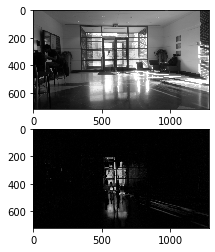

Iteration 281: error=4.073e-05, rank=11, nnz=23540106, time=1.297e+00
Iteration 282: error=4.233e-05, rank=10, nnz=23540078, time=1.192e+00
Iteration 283: error=4.974e-05, rank=11, nnz=23540774, time=1.084e+00
Iteration 284: error=5.362e-05, rank=11, nnz=23541393, time=1.196e+00
Iteration 285: error=5.323e-05, rank=12, nnz=23548760, time=1.197e+00
Iteration 286: error=4.181e-05, rank=12, nnz=23558953, time=1.277e+00
Iteration 287: error=4.234e-05, rank=12, nnz=23555631, time=1.298e+00
Iteration 288: error=4.523e-05, rank=12, nnz=23552866, time=1.297e+00
Iteration 289: error=4.585e-05, rank=11, nnz=23552702, time=1.280e+00
Iteration 290: error=5.541e-05, rank=11, nnz=23547663, time=1.197e+00
Iteration 291: error=5.655e-05, rank=11, nnz=23542535, time=1.193e+00
Iteration 292: error=4.459e-05, rank=11, nnz=23557448, time=1.182e+00
Iteration 293: error=4.283e-05, rank=11, nnz=23562576, time=1.190e+00
Iteration 294: error=5.014e-05, rank=11, nnz=23567755, time=1.196e+00
Iteration 295: error

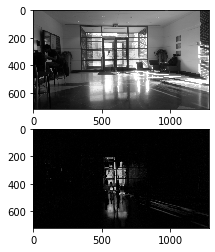

Iteration 301: error=3.249e-05, rank=11, nnz=23577914, time=1.255e+00
Iteration 302: error=3.327e-05, rank=11, nnz=23581348, time=1.181e+00
Iteration 303: error=2.917e-05, rank=11, nnz=23588615, time=1.189e+00
Iteration 304: error=2.921e-05, rank=11, nnz=23587157, time=1.167e+00
Iteration 305: error=3.417e-05, rank=11, nnz=23581913, time=1.178e+00
Iteration 306: error=2.984e-05, rank=11, nnz=23588402, time=1.195e+00
Iteration 307: error=3.020e-05, rank=11, nnz=23586507, time=1.167e+00
Iteration 308: error=2.992e-05, rank=12, nnz=23583568, time=1.180e+00
Iteration 309: error=3.017e-05, rank=11, nnz=23584230, time=1.292e+00
Iteration 310: error=2.888e-05, rank=11, nnz=23584415, time=1.173e+00
Iteration 311: error=3.693e-05, rank=12, nnz=23574693, time=1.179e+00
Iteration 312: error=3.173e-05, rank=11, nnz=23580448, time=1.292e+00
Iteration 313: error=3.107e-05, rank=11, nnz=23581889, time=1.167e+00
Iteration 314: error=3.222e-05, rank=12, nnz=23580575, time=1.177e+00
Iteration 315: error

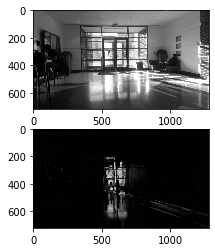

Iteration 321: error=2.833e-05, rank=11, nnz=23597051, time=1.094e+00
Iteration 322: error=3.563e-05, rank=11, nnz=23580712, time=1.169e+00
Iteration 323: error=3.221e-05, rank=11, nnz=23584437, time=1.183e+00
Iteration 324: error=2.998e-05, rank=11, nnz=23589055, time=1.185e+00
Iteration 325: error=2.846e-05, rank=11, nnz=23593715, time=1.231e+00
Iteration 326: error=2.732e-05, rank=10, nnz=23598215, time=1.213e+00
Iteration 327: error=2.611e-05, rank=10, nnz=23601720, time=1.109e+00
Iteration 328: error=2.684e-05, rank=10, nnz=23598518, time=1.311e+00
Iteration 329: error=2.578e-05, rank=10, nnz=23599533, time=1.061e+00
Iteration 330: error=2.616e-05, rank=10, nnz=23599676, time=1.043e+00
Iteration 331: error=2.634e-05, rank=10, nnz=23597021, time=1.112e+00
Iteration 332: error=3.842e-05, rank=10, nnz=23584948, time=1.225e+00
Iteration 333: error=3.029e-05, rank=10, nnz=23588790, time=1.196e+00
Iteration 334: error=2.832e-05, rank=10, nnz=23590954, time=1.167e+00
Iteration 335: error

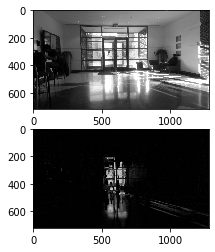

Iteration 341: error=2.862e-05, rank=11, nnz=23578475, time=1.241e+00
Iteration 342: error=2.674e-05, rank=11, nnz=23582615, time=1.248e+00
Iteration 343: error=2.738e-05, rank=10, nnz=23582053, time=1.221e+00
Iteration 344: error=2.791e-05, rank=11, nnz=23577237, time=1.190e+00
Iteration 345: error=2.851e-05, rank=12, nnz=23569698, time=1.247e+00
Iteration 346: error=2.886e-05, rank=12, nnz=23570113, time=1.325e+00
Iteration 347: error=3.050e-05, rank=13, nnz=23566701, time=1.310e+00
Iteration 348: error=3.038e-05, rank=13, nnz=23563046, time=1.431e+00
Iteration 349: error=2.798e-05, rank=11, nnz=23565372, time=1.412e+00
Iteration 350: error=2.957e-05, rank=12, nnz=23561684, time=1.166e+00
Iteration 351: error=2.999e-05, rank=11, nnz=23562756, time=1.275e+00
Iteration 352: error=2.660e-05, rank=11, nnz=23570278, time=1.191e+00
Iteration 353: error=2.739e-05, rank=10, nnz=23570560, time=1.169e+00
Iteration 354: error=2.566e-05, rank=11, nnz=23571364, time=1.086e+00
Iteration 355: error

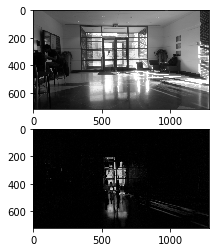

Iteration 361: error=3.178e-05, rank=11, nnz=23564655, time=1.110e+00
Iteration 362: error=2.797e-05, rank=12, nnz=23571399, time=1.195e+00
Iteration 363: error=2.573e-05, rank=11, nnz=23574935, time=1.328e+00
Iteration 364: error=2.653e-05, rank=12, nnz=23574687, time=1.175e+00
Iteration 365: error=2.571e-05, rank=11, nnz=23575988, time=1.292e+00
Iteration 366: error=2.523e-05, rank=10, nnz=23577785, time=1.218e+00
Iteration 367: error=2.604e-05, rank=11, nnz=23578920, time=1.126e+00
Iteration 368: error=2.629e-05, rank=11, nnz=23574135, time=1.207e+00
Iteration 369: error=2.349e-05, rank=11, nnz=23578172, time=1.197e+00
Iteration 370: error=3.316e-05, rank=11, nnz=23558127, time=1.192e+00
Iteration 371: error=2.592e-05, rank=10, nnz=23570308, time=1.209e+00
Iteration 372: error=2.565e-05, rank=11, nnz=23571734, time=1.102e+00
Iteration 373: error=2.635e-05, rank=11, nnz=23569120, time=1.189e+00
Iteration 374: error=2.760e-05, rank=10, nnz=23564227, time=1.208e+00
Iteration 375: error

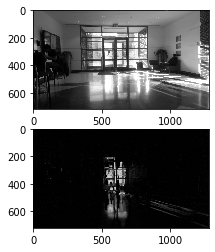

Iteration 381: error=3.018e-05, rank=12, nnz=23556765, time=1.202e+00
Iteration 382: error=2.535e-05, rank=12, nnz=23562887, time=1.290e+00
Iteration 383: error=2.455e-05, rank=11, nnz=23565788, time=1.307e+00
Iteration 384: error=2.268e-05, rank=11, nnz=23571770, time=1.203e+00
Iteration 385: error=2.265e-05, rank=11, nnz=23568936, time=1.192e+00
Iteration 386: error=2.226e-05, rank=11, nnz=23569425, time=1.205e+00
Iteration 387: error=2.746e-05, rank=11, nnz=23561174, time=1.206e+00
Iteration 388: error=3.292e-05, rank=10, nnz=23555862, time=1.191e+00
Iteration 389: error=2.919e-05, rank=10, nnz=23556902, time=1.139e+00
Iteration 390: error=3.149e-05, rank=10, nnz=23556350, time=1.110e+00
Iteration 391: error=2.795e-05, rank=11, nnz=23559443, time=1.091e+00
Iteration 392: error=2.653e-05, rank=11, nnz=23556583, time=1.206e+00
Iteration 393: error=2.825e-05, rank=12, nnz=23550719, time=1.211e+00
Iteration 394: error=2.753e-05, rank=10, nnz=23554505, time=1.286e+00
Iteration 395: error

Iteration 399: error=2.588e-05, rank=10, nnz=23561337, time=1.212e+00


In [17]:
L_pcp, S_pcp, _, errors, ranks, nnzs = pcp(D, verbose=True, maxiter=400, plot_num=20, im_shape=images.shape[1:3])

In [17]:
# L_pcp = 255*np.load('/home/spencer/research/radar-rgb-bfs/output/normal_L.npy')
# S_pcp = 255*np.load('/home/spencer/research/radar-rgb-bfs/output/normal_S.npy')

mu = 0.0024706205892880513
Iteration 0: error=2.691e-03, rank=50, nnz=524072, time=1.865e+00


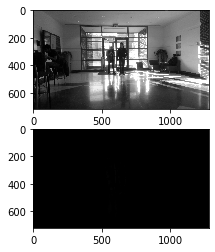

Iteration 1: error=1.285e-04, rank=50, nnz=558802, time=1.816e+00
Iteration 2: error=6.153e-05, rank=50, nnz=575811, time=1.813e+00
Iteration 3: error=5.111e-05, rank=50, nnz=590271, time=1.789e+00
Iteration 4: error=4.605e-05, rank=50, nnz=603611, time=1.790e+00
Iteration 5: error=4.210e-05, rank=50, nnz=616039, time=1.711e+00
Iteration 6: error=3.920e-05, rank=50, nnz=627748, time=1.789e+00
Iteration 7: error=3.618e-05, rank=50, nnz=638585, time=1.943e+00
Iteration 8: error=3.367e-05, rank=50, nnz=648638, time=1.844e+00
Iteration 9: error=3.133e-05, rank=50, nnz=658265, time=2.262e+00
Iteration 10: error=2.972e-05, rank=50, nnz=667458, time=2.256e+00
Iteration 11: error=2.850e-05, rank=50, nnz=676138, time=2.263e+00
Iteration 12: error=2.750e-05, rank=50, nnz=684695, time=2.268e+00
Iteration 13: error=2.675e-05, rank=50, nnz=693007, time=2.259e+00
Iteration 14: error=2.622e-05, rank=50, nnz=701071, time=2.334e+00
Iteration 15: error=2.601e-05, rank=50, nnz=708982, time=2.341e+00
Iter

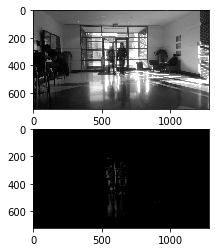

Iteration 21: error=2.544e-05, rank=50, nnz=754196, time=1.851e+00
Iteration 22: error=2.532e-05, rank=50, nnz=761763, time=1.957e+00
Iteration 23: error=2.516e-05, rank=50, nnz=769277, time=1.918e+00
Iteration 24: error=2.492e-05, rank=50, nnz=776574, time=1.856e+00
Iteration 25: error=2.466e-05, rank=50, nnz=783996, time=1.751e+00
Iteration 26: error=2.452e-05, rank=50, nnz=791419, time=1.776e+00
Iteration 27: error=2.439e-05, rank=50, nnz=798668, time=2.055e+00
Iteration 28: error=2.413e-05, rank=50, nnz=806060, time=7.385e+00
Iteration 29: error=2.394e-05, rank=50, nnz=813301, time=8.733e+00
Iteration 30: error=2.379e-05, rank=50, nnz=820790, time=5.839e+00
Iteration 31: error=2.361e-05, rank=50, nnz=828115, time=5.190e+00
Iteration 32: error=2.347e-05, rank=50, nnz=835216, time=1.692e+00
Iteration 33: error=2.326e-05, rank=50, nnz=842267, time=1.701e+00
Iteration 34: error=2.308e-05, rank=50, nnz=849309, time=1.702e+00
Iteration 35: error=2.282e-05, rank=50, nnz=856076, time=1.707

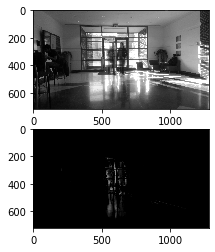

Iteration 41: error=2.141e-05, rank=50, nnz=896097, time=1.951e+00
Iteration 42: error=2.115e-05, rank=50, nnz=902232, time=6.238e+00
Iteration 43: error=2.087e-05, rank=50, nnz=908107, time=7.551e+00
Iteration 44: error=2.055e-05, rank=50, nnz=913903, time=4.642e+00
Iteration 45: error=2.025e-05, rank=50, nnz=919608, time=2.266e+00
Iteration 46: error=1.996e-05, rank=50, nnz=925092, time=1.813e+00
Iteration 47: error=1.969e-05, rank=50, nnz=930432, time=1.975e+00
Iteration 48: error=1.933e-05, rank=50, nnz=935552, time=1.795e+00
Iteration 49: error=1.905e-05, rank=50, nnz=940454, time=1.870e+00
Iteration 50: error=1.879e-05, rank=50, nnz=945306, time=2.291e+00
Iteration 51: error=1.857e-05, rank=50, nnz=949939, time=1.846e+00
Iteration 52: error=1.820e-05, rank=50, nnz=954526, time=1.805e+00
Iteration 53: error=1.794e-05, rank=50, nnz=958942, time=1.860e+00
Iteration 54: error=1.777e-05, rank=50, nnz=963438, time=2.471e+00
Iteration 55: error=1.742e-05, rank=50, nnz=967791, time=5.705

Iteration 59: error=1.638e-05, rank=50, nnz=983960, time=1.772e+00


In [41]:
L_radar, S_radar, _, errors_radar, ranks_radar, nnzs_radar = radar_pcp(D, M_F, verbose=True, maxiter=60, plot_num=20, im_shape=images.shape[1:3])

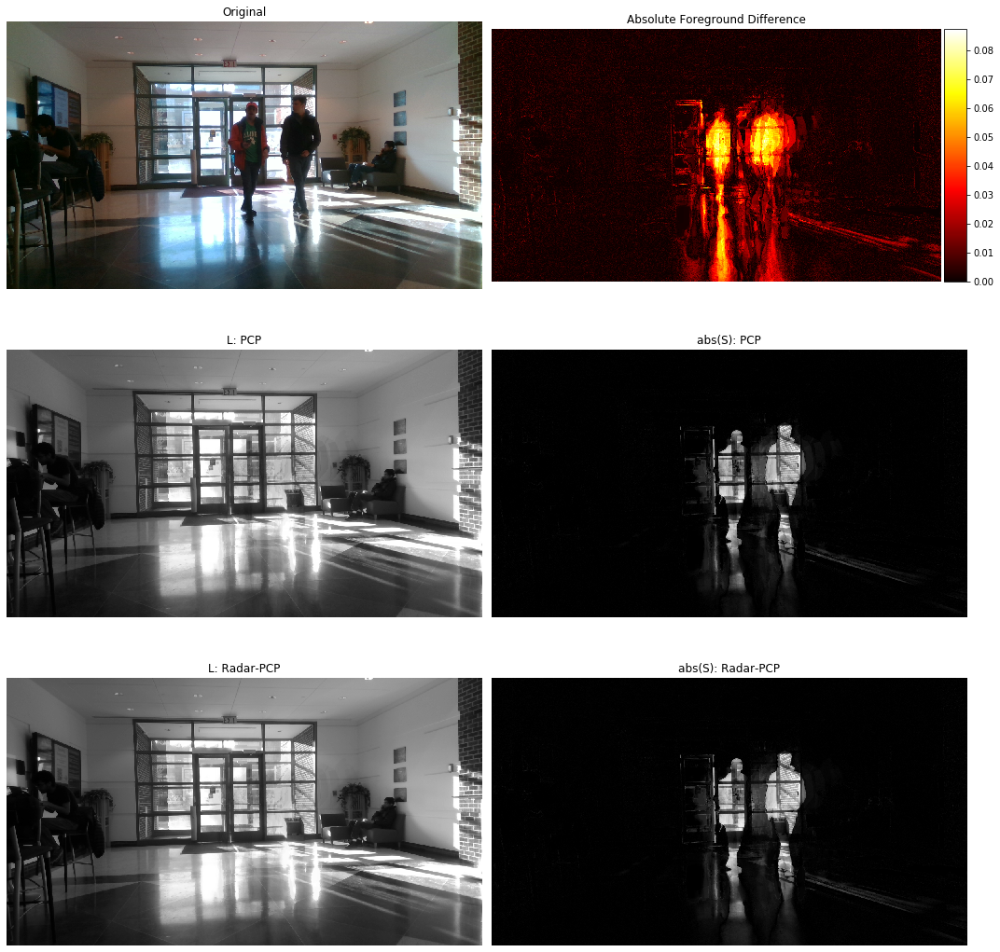

In [21]:
i = 10
plt.figure(figsize=(15,15))
plt.subplot(321)
plt.title('Original')
plt.imshow(images[i], 'gray')
plt.axis('off')
plt.subplot(322)
ax = plt.gca()

plt.title('Absolute Foreground Difference')
im = ax.imshow(np.abs((S_radar[:, i]-S_pcp[:, i])/255).reshape(images.shape[1], images.shape[2]), 'hot')
# plt.title('S_radar-S_normal')
# im = ax.imshow(((S_radar[:, i]-S_pcp[:, i])/255).reshape(images.shape[1], images.shape[2]), 'hot')

plt.axis('off')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.subplot(323)
plt.title('L: PCP')
plt.imshow(L_pcp[:, i].reshape(images.shape[1], images.shape[2]), 'gray')
plt.axis('off')
plt.subplot(324)
plt.title('abs(S): PCP')
plt.imshow(abs(S_pcp[:, i].reshape(images.shape[1], images.shape[2])), 'gray')
plt.axis('off')
plt.subplot(325)
plt.title('L: Radar-PCP')
plt.imshow(L_radar[:, i].reshape(images.shape[1], images.shape[2]), 'gray')
plt.axis('off')
plt.subplot(326)
plt.title('abs(S): Radar-PCP')
plt.imshow(abs(S_radar[:, i].reshape(images.shape[1], images.shape[2])), 'gray')
plt.axis('off')


plt.colorbar(im, cax=cax)
plt.tight_layout()

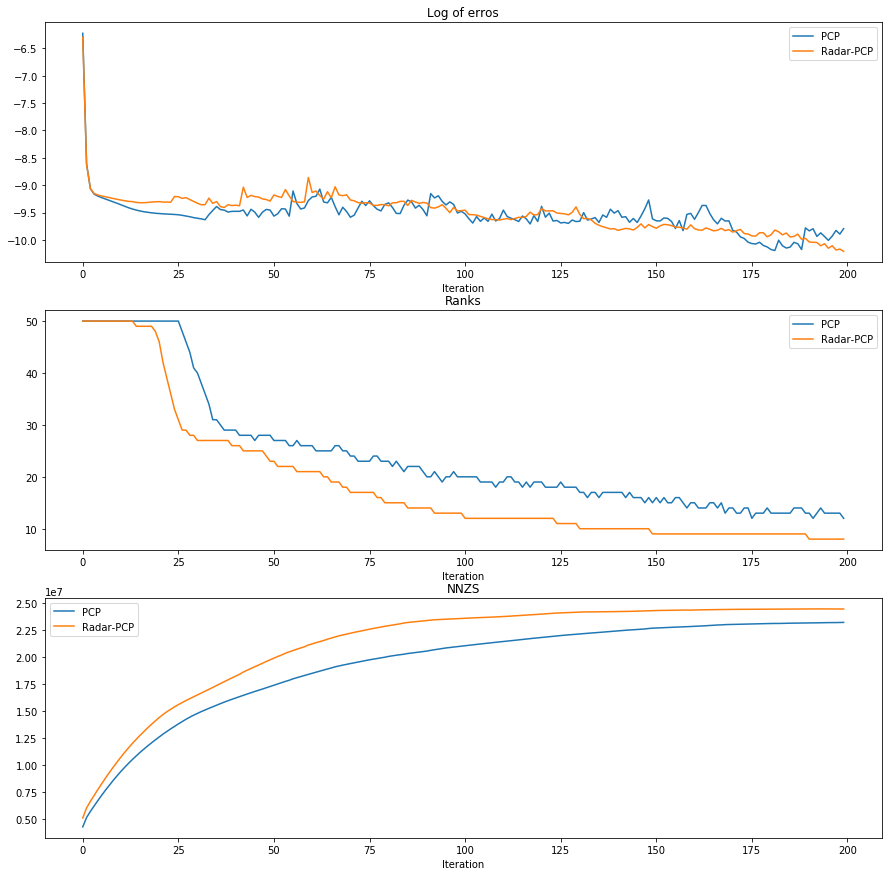

In [20]:
plt.figure(figsize=(15,15))
plt.subplot(311)
plt.plot(np.log(errors),label='PCP')
plt.plot(np.log(errors_radar),label='Radar-PCP')
plt.legend()
plt.title('Log of erros')
plt.xlabel('Iteration')
plt.subplot(312)
plt.plot(ranks,label='PCP')
plt.plot(ranks_radar,label='Radar-PCP')
plt.legend()
plt.title('Ranks')
plt.xlabel('Iteration')
plt.subplot(313)
plt.plot(nnzs,label='PCP')
plt.plot(nnzs_radar,label='Radar-PCP')
plt.legend()
plt.title('NNZS')
plt.xlabel('Iteration')
plt.show()

In [29]:
def save_images_from_combined(mat,image_shape,dir_name):
    n_im = mat.shape[1]
    for frame_idx in range(n_im):
        im = np.abs(mat[:,frame_idx])
        im = im.reshape(image_shape).astype(np.uint8)
        im_name = '/rgb_'+str(frame_idx)+'.png'
#         print(im.shape)
#         plt.imsave(dir_name+im_name,im)
        im = PIL.Image.fromarray(im)
        
        im.save(dir_name+im_name)
#         print(np.max(im))
        

In [42]:
save_images_from_combined(S_radar,images[0].shape[:2],'/home/spencer/research/radar-rgb-bfs/RGB_images/rpca_radar_preds_3_p5_60')

In [30]:
np.min(S_radar)

-254.26408651639719

In [47]:
test=plt.imread('/home/spencer/research/radar-rgb-bfs/RGB_images/rpca_radar_preds_1_p1/rgb_0.png')

In [48]:
test.shape

(720, 1280)